<a href="https://colab.research.google.com/github/spetryk/ai4all2020/blob/master/2-Exploring%20the%20fake%20image%20space.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# How to explore the input space to a generator
Inspired by [this](https://machinelearningmastery.com/how-to-interpolate-and-perform-vector-arithmetic-with-faces-using-a-generative-adversarial-network/) tutorial by Jason Brownlee.

Generators learn to map points in the space of **random noise** to the space of **images**. We call this random-noise-space the "latent" space, latent meaning "hidden". It's hidden because to us, the noise doesn't have any meaning - it's literally random numbers. It only has meaning to the generator model, which has been trained to create meaning out of these random numbers.


So, what does it mean to "explore" the latent space? It's all about vector arithmetic. If you have two vectors (or points in space) you can draw a line between them, and find the midpoint.

For our generator, those two points in space are two different images. We can "draw a line" between the two images in latent space and find the midpoint. What happens if we now pass the midpoint through the generator? We should get the "average" of the two images!


Let's try it out. First, we'll load up a generator that has already been trained.


In [ ]:
## For Google CoLab to set everything up
! git clone https://github.com/spetryk/ai4all2020.git
%cd ai4all2020/
%mkdir data

In [ ]:
# Install pretrained BigGAN model
! pip install pytorch-pretrained-biggan
! pip install nltk

In [1]:
%matplotlib inline
from tools import *
import torch
import torchvision.utils as vutils
import matplotlib.pyplot as plt
import numpy as np
from tqdm.notebook import tqdm
from pytorch_pretrained_biggan import BigGAN, one_hot_from_names, truncated_noise_sample, convert_to_images
from pytorch_pretrained_biggan import convert_to_images as convert_to_PIL

import matplotlib.animation as animation
from IPython.display import HTML
from matplotlib.animation import PillowWriter

# from https://stackoverflow.com/questions/51512141/how-to-make-matplotlib-saved-gif-looping
class LoopingPillowWriter(PillowWriter):
    def finish(self):
        self._frames[0].save(
            self._outfile, save_all=True, append_images=self._frames[1:],
            duration=int(1000 / self.fps), loop=0)
        
def convert_to_images(biggan_output):
    images = convert_to_PIL(biggan_output.cpu())
    images = [np.array(image) for image in images]
    return images

In [2]:
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /home/spetryk/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [3]:
# Load the pretrained BigGAN model
generator = BigGAN.from_pretrained('biggan-deep-512')

# Use a GPU if available, or you can choose to use the CPU by setting use_cpu = True
use_cpu = False
device = 'cuda:1' if (torch.cuda.is_available() and not use_cpu) else 'cpu'
print('Using device {}\n'.format(device))


Using device cuda:1



Next, we'll choose two random points in the latent space to interpolate between.

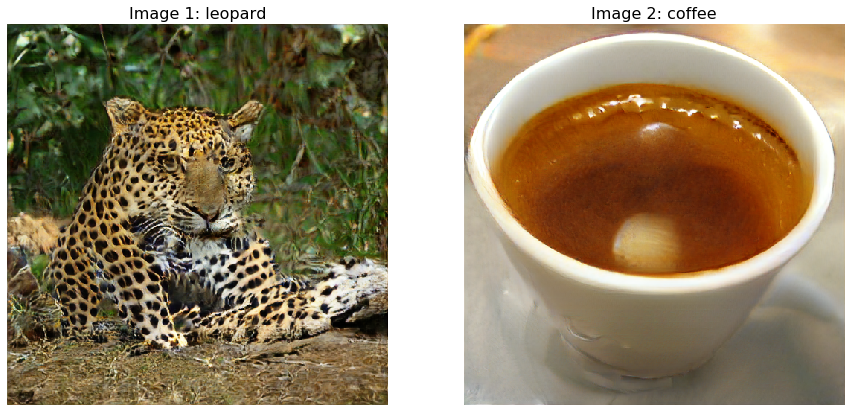

In [4]:
classes = ['leopard', 'coffee']

# Prepare an input
truncation = 0.4
class_vector = one_hot_from_names(classes, batch_size=len(classes))
noise_vector = truncated_noise_sample(truncation=truncation, batch_size=len(classes))

# All in tensors
noise_vector = torch.from_numpy(noise_vector)
class_vector = torch.from_numpy(class_vector)

# Put everything on the correct device
noise_vector = noise_vector.to(device)
class_vector = class_vector.to(device)
generator.to(device)

# Pass noise through generator and visualize the images it creates
with torch.no_grad():
    output = generator(noise_vector, class_vector, truncation)

images = convert_to_images(output)

# Plot the generated images    
fig, ax = plt.subplots(1,2,figsize=(15,10))
for column in range(2):
    ax[column].axis('off')

ax[0].set_title('Image 1: {}'.format(classes[0]), fontsize=16)
ax[1].set_title('Image 2: {}'.format(classes[1]), fontsize=16)
ax[0].imshow(images[0])
ax[1].imshow(images[1])
#ax[0].imshow(visualize(image1[0].detach()))
#ax[1].imshow(visualize(image2[0].detach()))
plt.show()


### Creating "midway" image

We now have our noise vectors, noise1 and noise2. Let's do the following:

1. Calculate the midway point
2. Pass it through the generator
3. Visualize the result



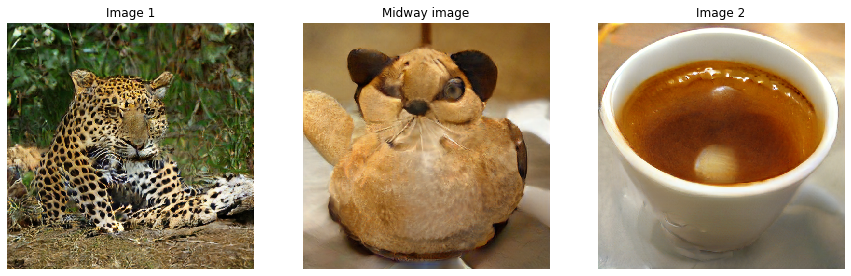

In [5]:
# TODO: calculate the midway point
midway_point = 0.5*noise_vector[0] + 0.5*noise_vector[1] # TODO

midway_image = generator(midway_point.unsqueeze(0), class_vector.sum(dim=0, keepdims=True)*0.5, truncation) # TODO
midway_image = convert_to_images(midway_image)

# Plot the images
fig, ax = plt.subplots(1,3,figsize=(15,5))
for column in range(3):
    ax[column].axis('off')

ax[0].set_title('Image 1')
ax[1].set_title('Midway image')
ax[2].set_title('Image 2')

ax[0].imshow(images[0])
ax[1].imshow(midway_image[0])
ax[2].imshow(images[1])
plt.show()

Looks cool! (hopefully you are impressed..)


But wait - there is a whole **line** of points between Image 1 and Image 2. Right now, we're only visualizing the middle point. Which brings us to:

### Transitioning smoothly between images

You know how the motion in a video looks like it's smooth, but it's really just a bunch of frames playing one after another? We'll do the same thing here to make a smooth interpolation between Image 1 and 2.

To code this up, we'll define the number of frames we want, calculate each frame, put them into a list, and loop through the list to create a video.

Hint: [This function](https://pytorch.org/docs/master/generated/torch.linspace.html) will be helpful!



In [6]:
torch.where(class_vector)

(tensor([0, 1], device='cuda:1'), tensor([288, 967], device='cuda:1'))

In [27]:


num_frames = 20

# Initialize frames to empty list. We'll add on to it each iteration of the loop.
frames = []

fractions = torch.linspace(0,1,num_frames)

for i in range(num_frames):
    # Calculate what each frame should be

    noise     = ((1-fractions[i].item())*noise_vector[0]) + (fractions[i].item()*noise_vector[1]) # TODO
    class_vec = ((1-fractions[i].item())*class_vector[0]) + (fractions[i].item()*class_vector[1])
    
    frame = generator(noise.unsqueeze(0), class_vec.unsqueeze(0), truncation) # TODO
    frame = convert_to_images(frame)
    frames.append(frame[0])
    


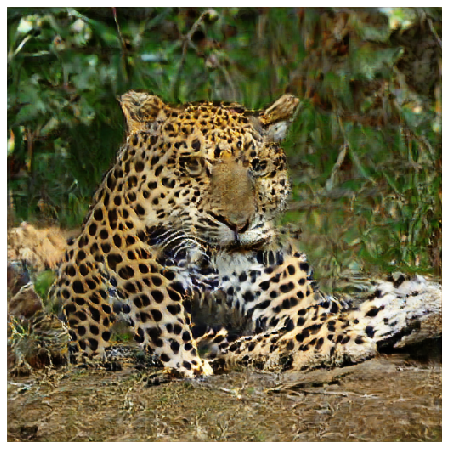

In [29]:
# Visualize progression

# Hack: to make gif go from A -> B -> A,
# add a backwards list to the end of the list
frames_viz = frames + frames[::-1][1:]

# Plot
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(frame, animated=True)] for frame in frames_viz]
ani = animation.ArtistAnimation(fig, ims, interval=100, repeat_delay=0, blit=True)
#ani.save('interpolation_biggan.gif', writer=LoopingPillowWriter(fps=20))

HTML(ani.to_jshtml())


